In [1]:
%load_ext autoreload
%autoreload 2
import matplotlib.pyplot as plt
from wbfm.utils.projects.finished_project_data import ProjectData
import napari
import pandas as pd
from tqdm.auto import tqdm
import numpy as np
from collections import defaultdict
import zarr
from pathlib import Path
import os
import seaborn as sns

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")


In [2]:
from sklearn.decomposition import PCA
from wbfm.utils.visualization.plot_traces import make_grid_plot_from_dataframe
import seaborn as sns
from wbfm.utils.visualization.filtering_traces import fill_nan_in_dataframe
import plotly.express as px

In [3]:
# fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/2022-11-27_spacer_7b_2per_agar/ZIM2165_Gcamp7b_worm1-2022_11_28/project_config.yaml"
# Manually corrected version
fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/manually_annotated/paper_data/ZIM2165_Gcamp7b_worm1-2022_11_28/project_config.yaml"
project_data_gcamp = ProjectData.load_final_project_data_from_config(fname)

ConfigFile  : INFO     =======================================
Project data for directory:
/scratch/neurobiology/zimmer/Charles/dlc_stacks/manually_annotated/paper_data/ZIM2165_Gcamp7b_worm1-2022_11_28 
With raw data in directory:
/scratch/neurobiology/zimmer/ulises/wbfm/20221127/data/ZIM2165_Gcamp7b_worm1/2022-11-27_15-14_ZIM2165_worm1_GC7b_Ch0-BH 

Found the following data files:
============Raw========================
red_data:                 True
green_data:               True
============Annotations================
manual_tracking:          True
============Segmentation===============
raw_segmentation:         True
colored_segmentation:     False
============Traces=====================
traces:                   True



In [7]:
fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/2022-12-10_spacer_7b_2per_agar_GFP/ZIM2319_GFP_worm1-2022-12-10/project_config.yaml"
project_data_gfp = ProjectData.load_final_project_data_from_config(fname)

ConfigFile  : INFO     =======================================
Project data for directory:
/scratch/neurobiology/zimmer/Charles/dlc_stacks/2022-12-10_spacer_7b_2per_agar_GFP/ZIM2319_GFP_worm1-2022-12-10 
With raw data in directory:
/scratch/neurobiology/zimmer/ulises/wbfm/20221210_GFP/data/ZIM2319_GFP_worm1/2022-12-10_20-44_ZIM2319_worm1_Ch0-BH 

Found the following data files:
============Raw========================
red_data:                 True
green_data:               True
============Annotations================
manual_tracking:          True
============Segmentation===============
raw_segmentation:         True
colored_segmentation:     True
============Traces=====================
traces:                   True



In [8]:
fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/immobilization_tests/2022-12-12_immob/2022-12-13_15-16_ZIM2165_immob_worm9-2022-12-13/project_config.yaml"
project_data_immob = ProjectData.load_final_project_data_from_config(fname)

ConfigFile  : INFO     =======================================
Project data for directory:
/scratch/neurobiology/zimmer/Charles/dlc_stacks/immobilization_tests/2022-12-12_immob/2022-12-13_15-16_ZIM2165_immob_worm9-2022-12-13 
With raw data in directory:
None 

Found the following data files:
============Raw========================
red_data:                 True
green_data:               True
============Annotations================
manual_tracking:          False
============Segmentation===============
raw_segmentation:         True
colored_segmentation:     True
============Traces=====================
traces:                   True



In [221]:
# Load multiple datasets
from wbfm.utils.visualization.hardcoded_paths import load_paper_datasets
all_projects_gcamp = load_paper_datasets('gcamp')
all_projects_gfp = load_paper_datasets('gfp')
all_projects_immob = load_paper_datasets('immob')

  0%|          | 0/23 [00:00<?, ?it/s]

Loaded 23 projects


  0%|          | 0/8 [00:00<?, ?it/s]

Loaded 8 projects


  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

Loaded 11 projects


In [10]:
output_foldername = 'basic_triggered_average'

# Calculations

In [28]:
opt = dict(interpolate_nan=True, 
           filter_mode='rolling_mean', 
           min_nonnan=0.9,
           nan_tracking_failure_points=True,
           nan_using_ppca_manifold=True,
           channel_mode='dr_over_r_50')

## Traces

In [12]:
df_traces = project_data_gcamp.calc_default_traces(**opt)

In [13]:
df_traces_with_nan = df_traces.copy()
df_traces_no_nan = df_traces_with_nan.copy()
df_traces_no_nan.fillna(df_traces_with_nan.mean(), inplace=True)

## GFP

In [14]:

df_traces_gfp = project_data_gfp.calc_default_traces(**opt)

In [34]:
df_traces_gfp_with_nan = df_traces_gfp.copy()
df_traces_gfp_no_nan = fill_nan_in_dataframe(df_traces_gfp_with_nan, do_filtering=True)

## Immobilized

In [37]:

df_traces_immob = project_data_immob.calc_default_traces(**opt)

In [39]:
df_traces_immob_with_nan = df_traces_immob.copy()
df_traces_immob_no_nan = fill_nan_in_dataframe(df_traces_immob_with_nan, do_filtering=True)

# Plots

## Heatmaps: immobilized and WBFM

In [84]:
from wbfm.utils.visualization.plot_traces import make_summary_interactive_heatmap_with_pca

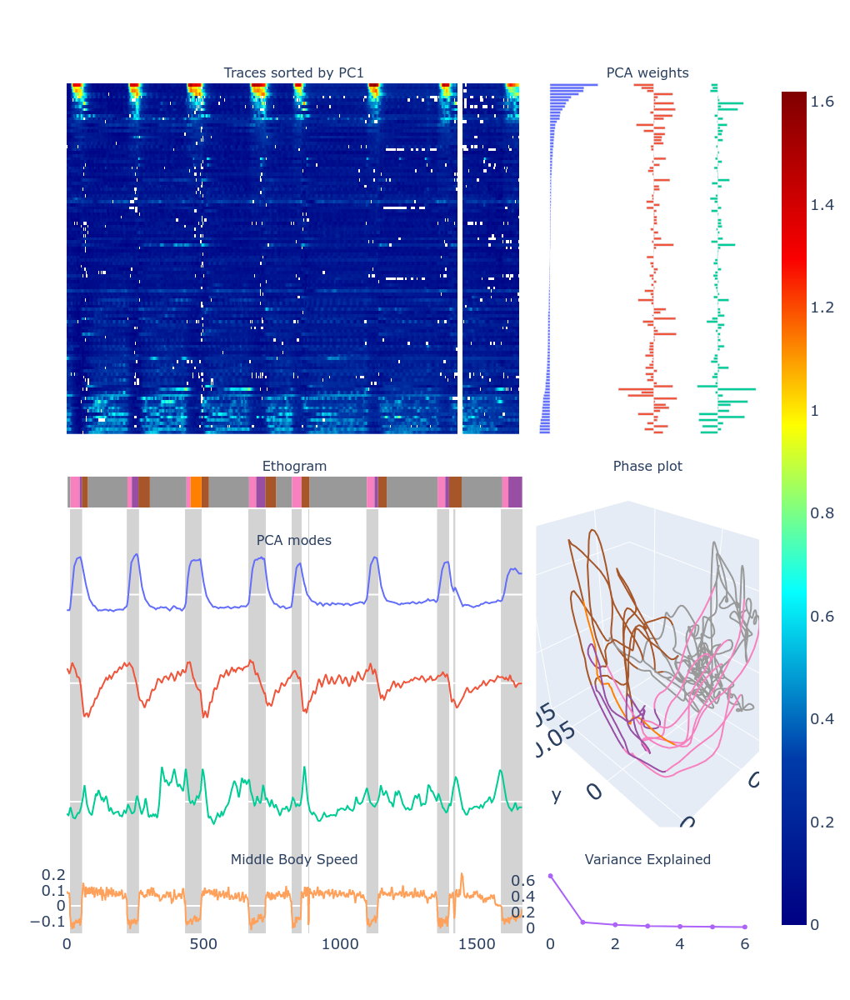

In [23]:
fig = make_summary_interactive_heatmap_with_pca(project_data_gcamp, to_save=True, to_show=True)

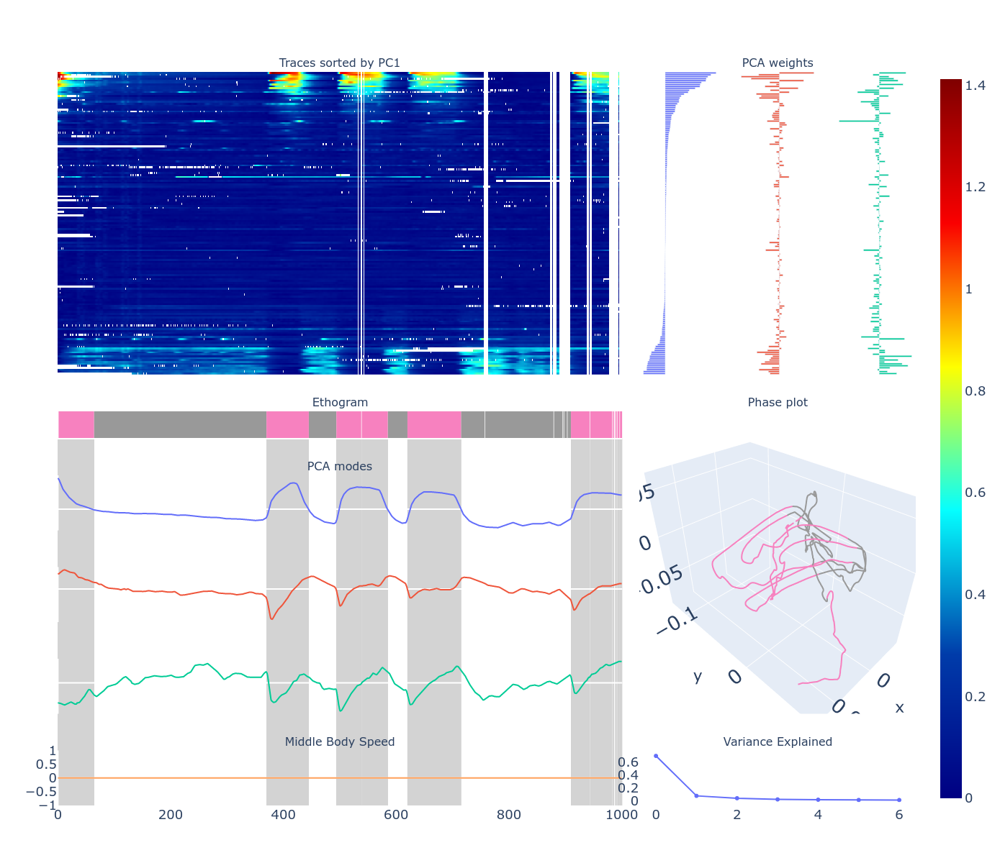

In [128]:
fig = make_summary_interactive_heatmap_with_pca(project_data_immob, to_save=True, to_show=True)

## Triggered average examples

In [135]:
from wbfm.utils.visualization.plot_traces import make_grid_plot_using_project
from wbfm.utils.traces.triggered_averages import FullDatasetTriggeredAverages
from wbfm.utils.external.utils_behavior_annotation import BehaviorCodes
from wbfm.utils.general.postures.centerline_classes import shade_using_behavior

In [218]:
# Do a set of ID-able neurons triggered to reverse, then forward

# First, do wbfm

def plot_triggered_averages(project_data_list):
    
    opt = dict(interpolate_nan=True, 
           filter_mode='rolling_mean', 
           min_nonnan=0.9,
           nan_tracking_failure_points=True,
           nan_using_ppca_manifold=True,
           channel_mode='dr_over_r_50')

    xlim = [0, 60]
    
    for neuron_base in ['AVA', 'RME', 'VB02', 'BAG']:
        for state in [BehaviorCodes.REV, BehaviorCodes.FWD]:
            
    
            fig, ax = plt.subplots(dpi=200)
            for i_trace, project_data in enumerate(project_data_list):
                
                df_traces = project_data.calc_default_traces(**opt)
                mapping = project_data.neuron_name_to_manual_id_mapping(remove_unnamed_neurons=True, confidence_threshold=0)
                mapping = {v: k for k, v in mapping.items()}
                
                ind_class = project_data.worm_posture_class.calc_triggered_average_indices(state=state)

                # Actually plot
                if neuron_base not in mapping:
                    if 'immob' in project_data.shortened_name:
                        # This dataset has the brighter side on the right side
                        neuron = f"{neuron_base}R"
                    else:
                        # This dataset has the brighter side on the left side
                        neuron = f"{neuron_base}L"
                else:
                    neuron = neuron_base
                neuron_ind = mapping[neuron]

                y = df_traces[neuron_ind]
                mat = ind_class.calc_triggered_average_matrix(y)
                # all_medians.append(np.nanmean(mat))
                ind_class.plot_triggered_average_from_matrix(mat, ax=ax, is_second_plot=(i_trace>0))
                ax.set_title(f"{neuron}")
                ax.set_xlim(xlim)

                # Make a fake behavioral vector to shade this
                fake_beh = np.zeros(xlim[1]+10)
                fake_beh[:] = BehaviorCodes.FWD
                if state == BehaviorCodes.FWD:
                    fake_beh[:21] = BehaviorCodes.REV
                else:
                    fake_beh[20:] = BehaviorCodes.REV
                shade_using_behavior(fake_beh, ax=ax)

            # Save
            fname = f"multiproject-{neuron}-{state}.png"
            # if 'immob' in fname:
            #     fname = os.path.join(output_foldername, 'immob', fname)
            # else:
            #     fname = os.path.join(output_foldername, 'gcamp', fname)
            fname = os.path.join(output_foldername, fname)
            plt.savefig(fname)
            
            plt.show()

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/triggered_averages.py:311: RuntimeWarning:

Mean of empty slice

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1583: RuntimeWarning:

All-NaN slice encountered



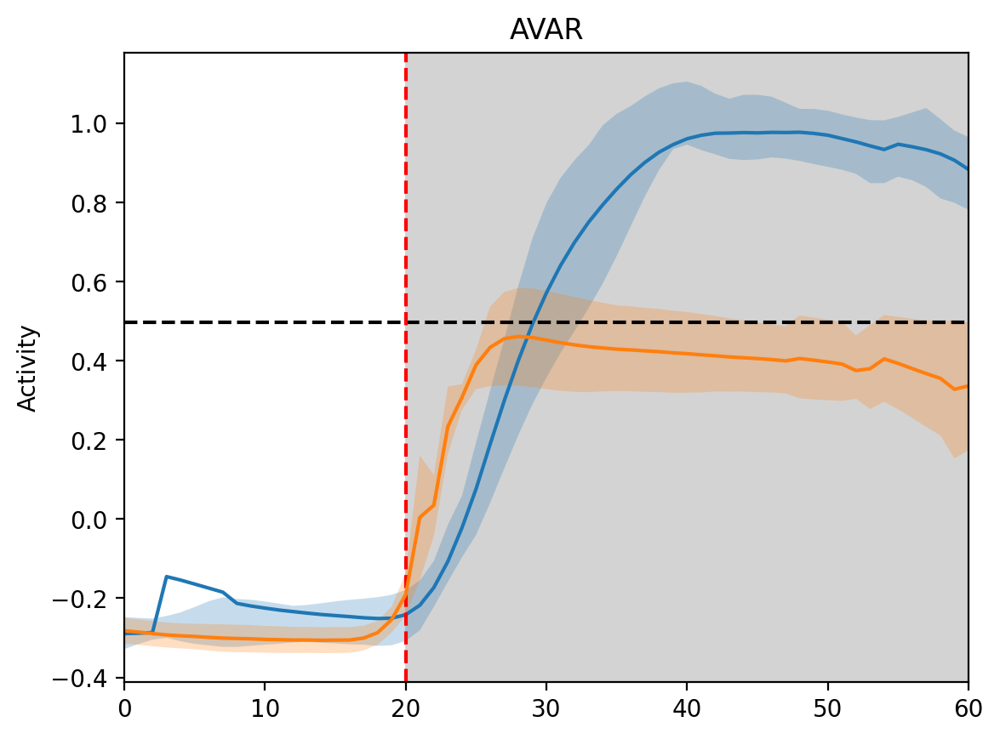

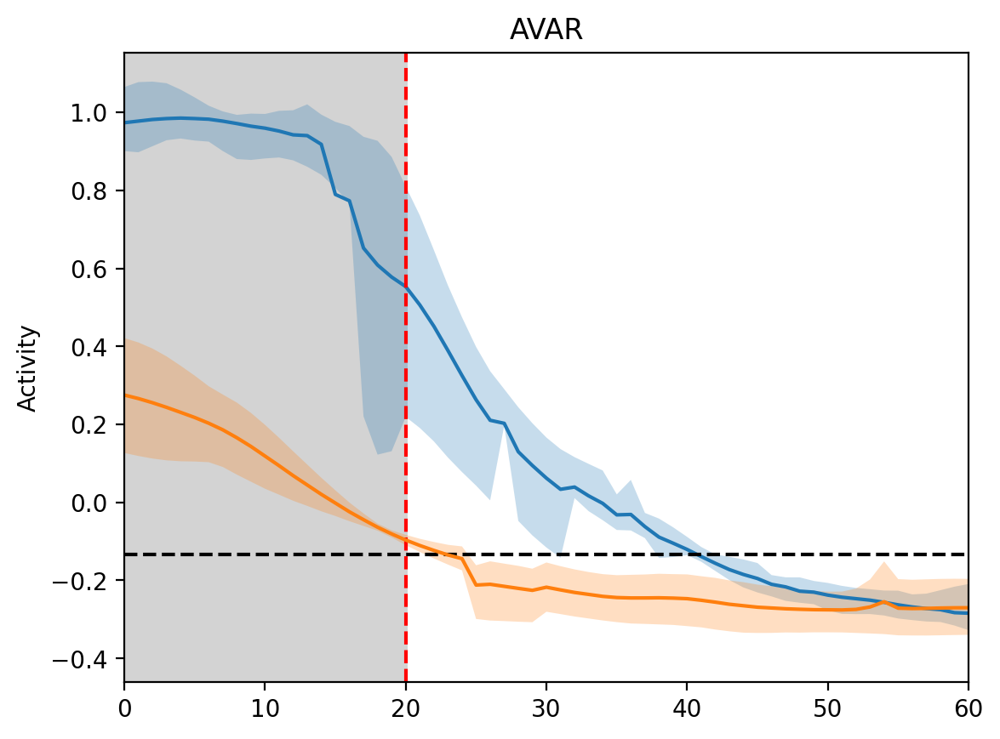

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/triggered_averages.py:311: RuntimeWarning:

Mean of empty slice

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1583: RuntimeWarning:

All-NaN slice encountered



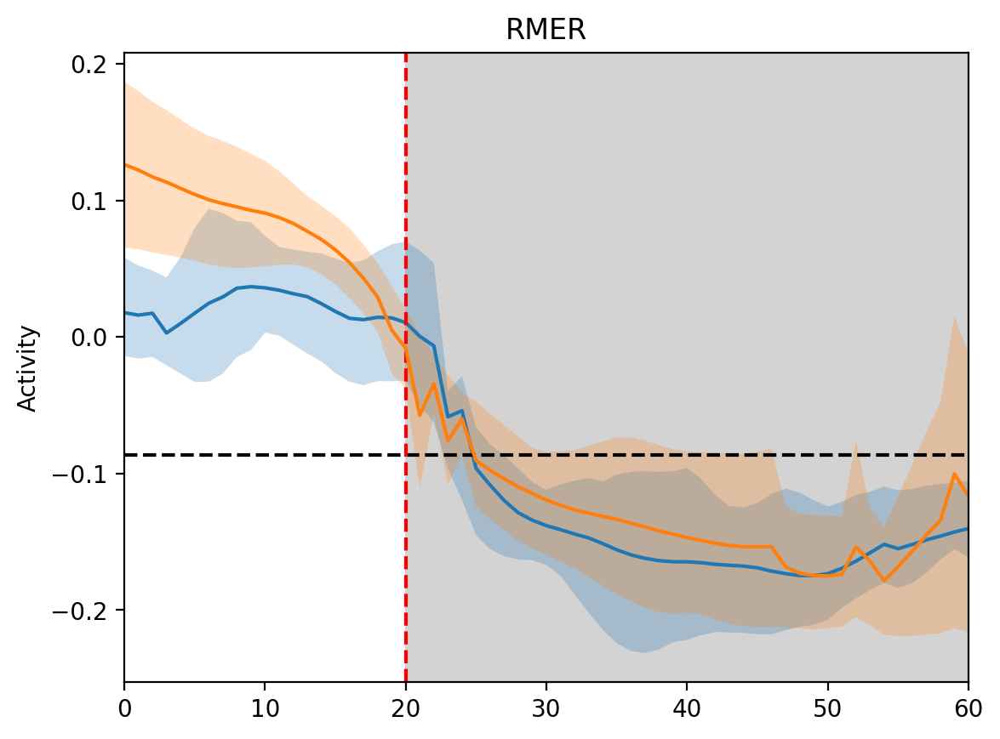

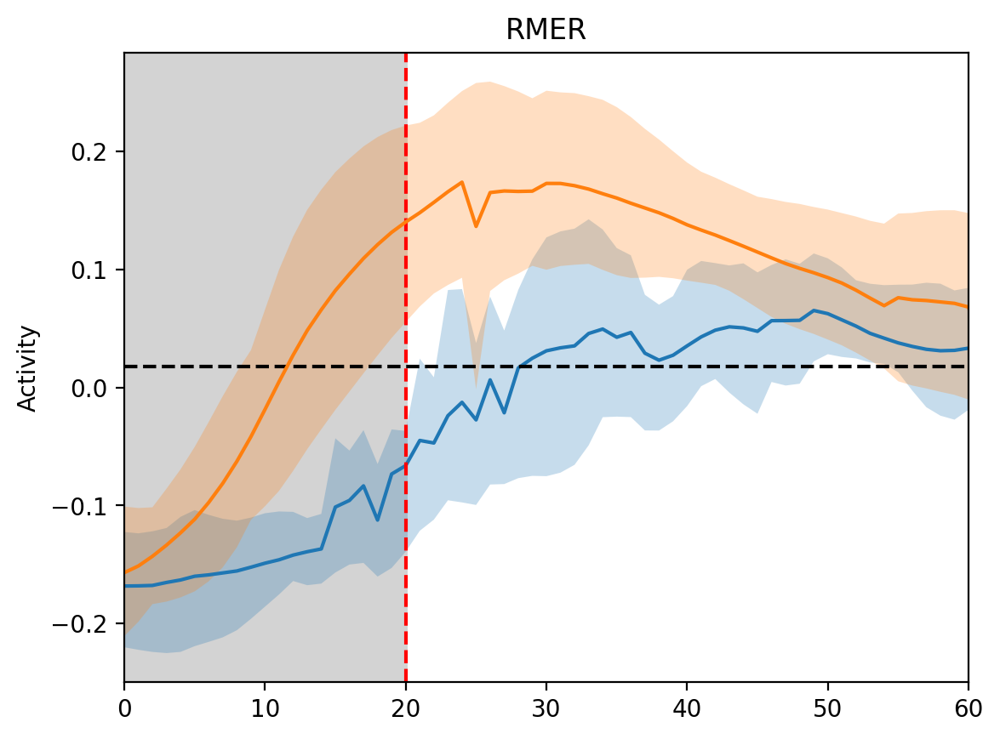

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/triggered_averages.py:311: RuntimeWarning:

Mean of empty slice

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1583: RuntimeWarning:

All-NaN slice encountered



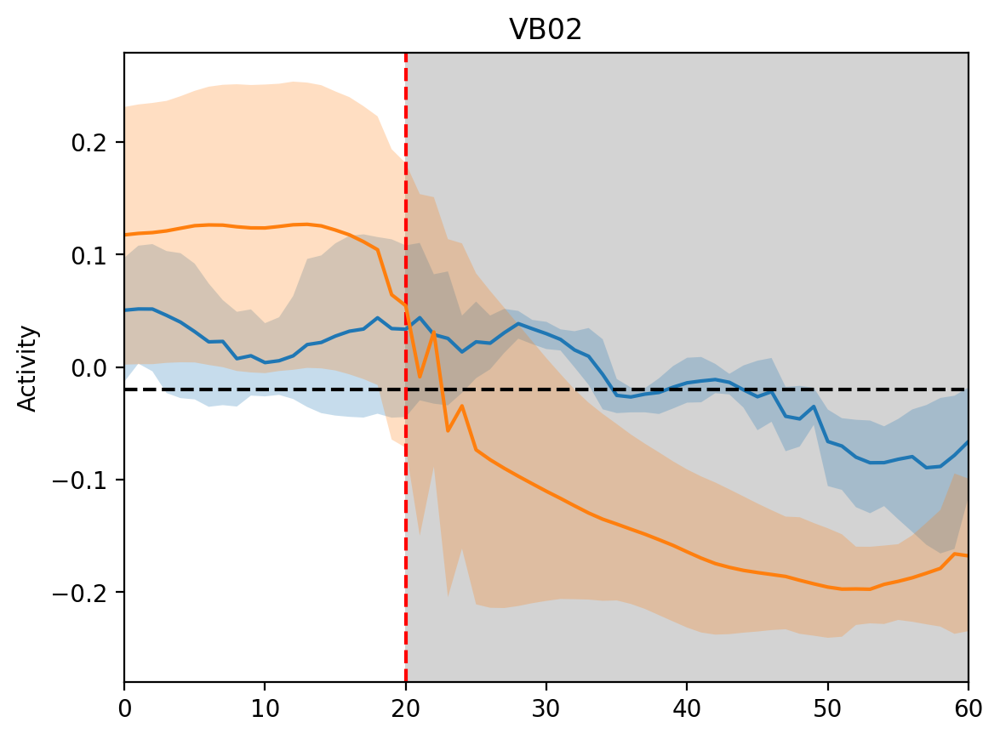

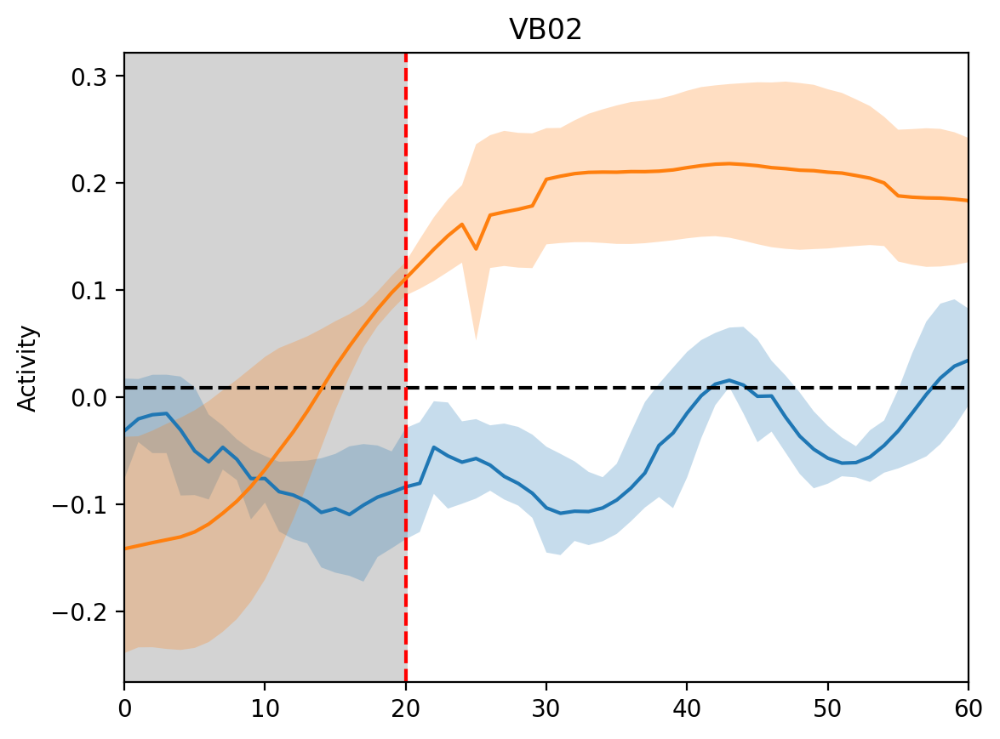

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/triggered_averages.py:311: RuntimeWarning:

Mean of empty slice

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1583: RuntimeWarning:

All-NaN slice encountered



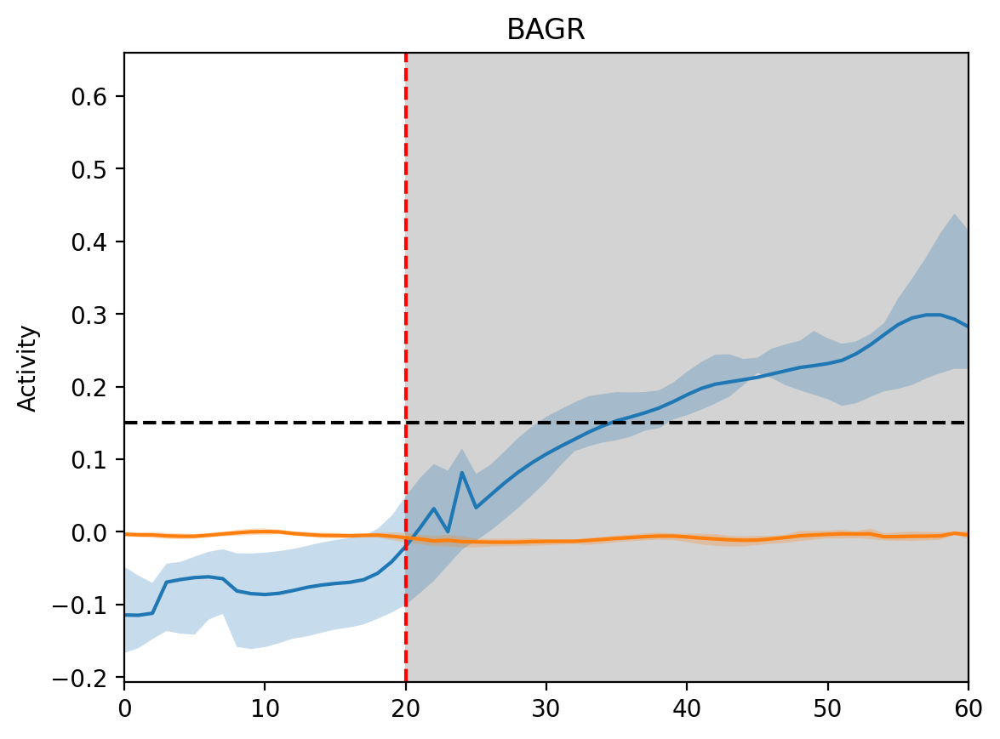

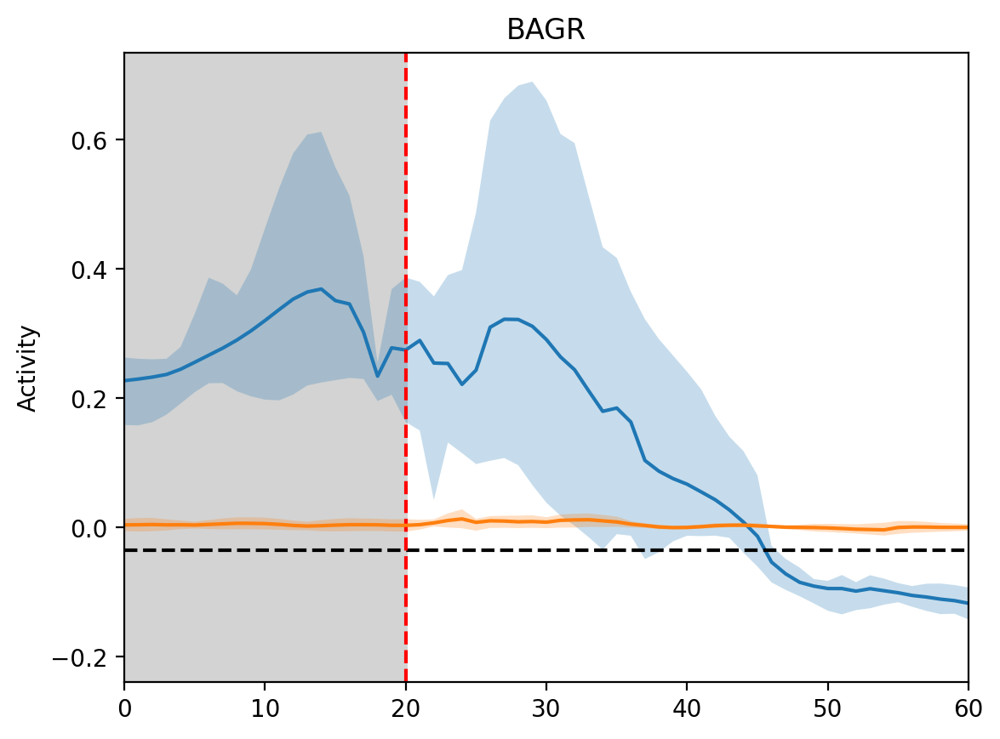

In [220]:
plot_triggered_averages([project_data_gcamp, project_data_immob])

## PCA variance explained plot of all datasets

In [227]:
from wbfm.utils.visualization.multiproject_wrappers import get_all_variance_explained
from wbfm.utils.visualization.utils_plot_traces import plot_with_shading

In [223]:
gcamp_var, gfp_var, immob_var, gcamp_var_sum, gfp_var_sum, immob_var_sum = get_all_variance_explained(all_projects_gcamp, all_projects_gfp, all_projects_immob)

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/8 [00:00<?, ?it/s]

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned



  0%|          | 0/11 [00:00<?, ?it/s]

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/ppca/_ppca.py:82: RuntimeWarning:

divide by zero encountered in log

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/ppca/_ppca.py:82: RuntimeWarning:

divide by zero encountered in log

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/ppca/_ppca.py:82: RuntimeWarning:

divide by zero encountered in log

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/ppca/_ppca.py:82: RuntimeWarning:

divide by zero encountered in log

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned

/home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/bleach_correction.py:78: RankWarning:

Polyfit may be poorly conditioned

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site-packages/ppca/_ppca.py:82: RuntimeWarning:

divide by zero encountered in log

/home/charles/anaconda3/envs/wbfm38/lib/python3.8/site

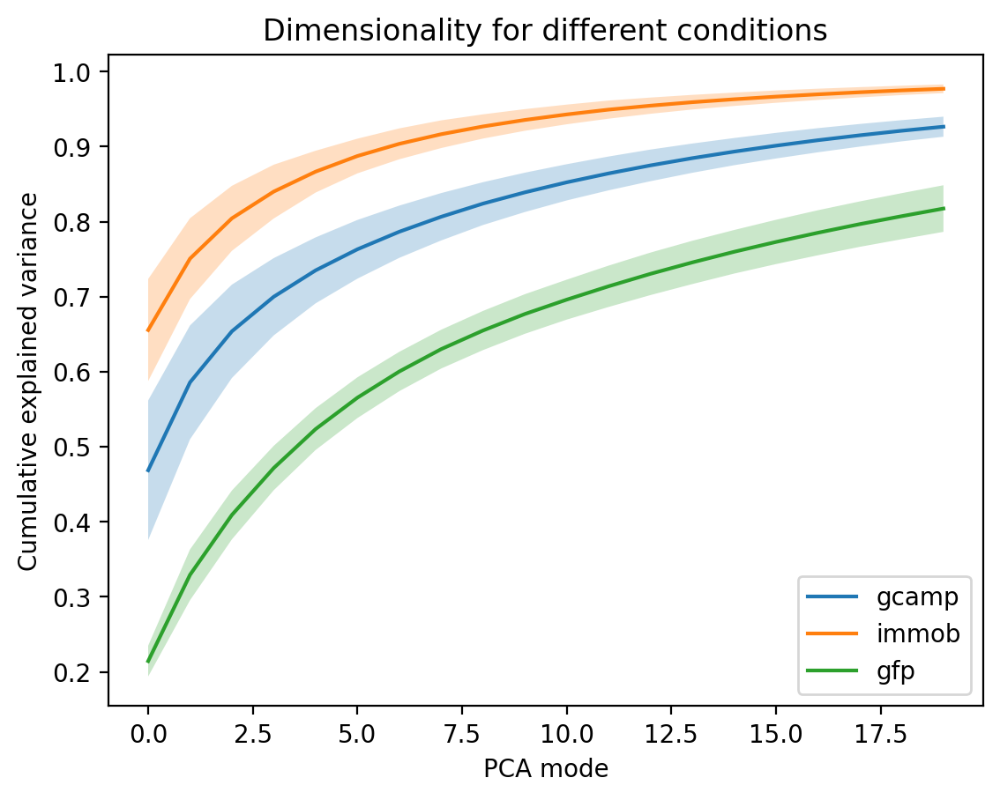

In [235]:
fig, ax = plt.subplots(dpi=200)

var_sum_dict = {'gcamp': gcamp_var_sum, 'immob': immob_var_sum, 'gfp': gfp_var_sum}

for name, mat in var_sum_dict.items():
    plot_with_shading(np.mean(mat, axis=1), np.std(mat, axis=1), label=name, ax=ax)
plt.legend()
plt.title("Dimensionality for different conditions")
plt.ylabel("Cumulative explained variance")
plt.xlabel("PCA mode")

fname = f"pca_cumulative_variance.png"
fname = os.path.join(output_foldername, fname)
plt.savefig(fname)

# Scratch: behavioral annotation for turns

In [209]:
del project_data_immob.__dict__['df_manual_tracking']


In [210]:
del project_data_gcamp.__dict__['df_manual_tracking']

In [11]:
from wbfm.utils.traces.triggered_averages import FullDatasetTriggeredAverages
from wbfm.utils.general.utils_behavior_annotation import BehaviorCodes
triggered_averages = FullDatasetTriggeredAverages.load_from_project(project_data_gcamp, trigger_opt=dict(state=BehaviorCodes.VENTRAL_TURN))

In [16]:
# fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/2022-11-27_spacer_7b_2per_agar/ZIM2165_Gcamp7b_worm1-2022_11_28/project_config.yaml"
# Manually corrected version
fname = "/scratch/neurobiology/zimmer/Charles/dlc_stacks/manually_annotated/paper_data/ZIM2165_Gcamp7b_worm1-2022_11_28/project_config.yaml"
project_data_gcamp = ProjectData.load_final_project_data_from_config(fname)

ConfigFile  : INFO     =======================================
Project data for directory:
/scratch/neurobiology/zimmer/Charles/dlc_stacks/manually_annotated/paper_data/ZIM2165_Gcamp7b_worm1-2022_11_28 
With raw data in directory:
/scratch/neurobiology/zimmer/ulises/wbfm/20221127/data/ZIM2165_Gcamp7b_worm1/2022-11-27_15-14_ZIM2165_worm1_GC7b_Ch0-BH 

Found the following data files:
============Raw========================
red_data:                 True
green_data:               True
============Annotations================
manual_tracking:          True
============Segmentation===============
raw_segmentation:         True
colored_segmentation:     False
============Traces=====================
traces:                   True



In [17]:
project_data_gcamp.worm_posture_class.beh_annotation()

0                       BehaviorCodes.FWD
1                       BehaviorCodes.FWD
2                       BehaviorCodes.FWD
3                       BehaviorCodes.FWD
4                       BehaviorCodes.FWD
                       ...               
40003    BehaviorCodes.SELF_COLLISION|REV
40004    BehaviorCodes.SELF_COLLISION|REV
40005    BehaviorCodes.SELF_COLLISION|REV
40006    BehaviorCodes.SELF_COLLISION|REV
40007    BehaviorCodes.SELF_COLLISION|REV
Length: 40008, dtype: object

In [12]:
triggered_averages.plot_single_neuron_triggered_average('neuron_060')

TypeError: unsupported operand type(s) for /: 'NoneType' and 'int'

In [6]:
%debug

> /home/charles/Current_work/repos/dlc_for_wbfm/wbfm/utils/traces/triggered_averages.py(272)nan_points_of_state_before_point()
    270             beh_annotations = self.cleaned_binary_state
    271         else:
--> 272             invalid_states = {self.behavioral_state, BehaviorCodes.UNKNOWN}
    273             beh_annotations = self.behavioral_annotation.to_numpy()
    274         for i_trace in range(len(list_of_triggered_ind)):



ipdb>  invalid_states = (self.behavioral_state, BehaviorCodes.UNKNOWN)
ipdb>  beh_annotations = self.behavioral_annotation.to_numpy()
ipdb>  q
